In [33]:
%matplotlib widget
import matplotlib.pyplot as plt
from mpl_interactions import ipyplot as iplt

import numpy as np
import sympy as sm
import sympy.physics.mechanics as me
from scipy.integrate import solve_ivp
import matplotlib.pyplot as plt
me.init_vprinting()
import control as ct
from control.matlab import *

t = me.dynamicsymbols._t



q1, q2, q3, q4, q5 = me.dynamicsymbols('q1, q2, q3, q4, q5')
u1, u2, u3, u4, u5 = me.dynamicsymbols('u1, u2, u3, u4, u5') # u1 must be diff because otherwise it doesnt show up in Fr* and it should
l, I, m, g, I_xx, I_yy, I_zz, h,  = sm.symbols('l, I, m, g, I_xx, I_yy, I_zz, h,')
t = me.dynamicsymbols._t

p = sm.Matrix([l, I, m, g, I_xx, I_yy, I_zz, h])
q = sm.Matrix([q1, q2, q3, q5])
us = sm.Matrix([u1, u5])
ur = sm.Matrix([u2, u3])
u = ur.col_join(us)
qd = q.diff()
qdd = qd.diff(t)
urd = ur.diff(t)
usd = us.diff(t)
ud = u.diff(t)

d_repl = {q4.diff(t): u4}
steer = sm.Matrix([q4, u4])

qd_zero = {qdi: 0 for qdi in qd}
ur_zero = {ui: 0 for ui in ur}
us_zero = {ui: 0 for ui in us}
urd_zero = {udi: 0 for udi in urd}
usd_zero = {udi: 0 for udi in usd}

N = me.ReferenceFrame('N')
A = me.ReferenceFrame('A')
B = me.ReferenceFrame('B')
C = me.ReferenceFrame('C')
D = me.ReferenceFrame('D')

A.orient_axis(N, q3, N.z) # only yaw for constraint
B.orient_body_fixed(N, (q3, q5,0), 'zxz') # bike with lean and yaw
C.orient_axis(A, q4, A.z) #frame with steer

N_w_B = B.ang_vel_in(N)

O = me.Point('O')
Ao = me.Point('A_o')
Bo = me.Point('B_o')
Co = me.Point('C_o')
COM = me.Point('COM')

Co.set_pos(O, q1*N.x + q2*N.y)
Ao.set_pos(Co, l/2*B.x)
Bo.set_pos(Ao, l/2*B.x)
COM.set_pos(Ao, h* B.z)

fk = sm.Matrix([
    u1 - q1.diff(t),
    u2 - q2.diff(t),
    u3 - q3.diff(t),
    u5 - q5.diff(t),
])

Mk = fk.jacobian(qd)
gk = fk.xreplace(qd_zero)
qd_sol = -Mk.LUsolve(gk)
qd_repl = dict(zip(qd, qd_sol))
qd_repl

O.set_vel(N, 0)

## vel Co, rear wheel point #
r_Co_O = Co.pos_from(O)
Co.set_vel(N, r_Co_O.diff(t,N)) # 
N_v_Co = Co.vel(N)

N_v_Ao = Ao.v2pt_theory(Co, N, A)
N_v_Bo = Bo.v2pt_theory(Ao, N, A)
N_v_COM = COM.v2pt_theory(Ao, N, B)



In [34]:
fn = sm.Matrix([Bo.vel(N).dot(C.y), Co.vel(N).dot(A.y)]) # C is in line with steer, A is the yaw
fn = fn.xreplace(qd_repl)
Mn = fn.jacobian(ur)
gn = fn.xreplace(ur_zero)
ur_sol = Mn.LUsolve(-gn)
ur_repl = dict(zip(ur, ur_sol))


gk = gk.xreplace(ur_repl)#.xreplace(vel_repl)
me.find_dynamicsymbols(fn)

sm.trigsimp(fn)
sm.trigsimp(ur_sol)


⎡(u₁⋅sin(q₃) - u₁⋅cos(q₃)⋅tan(q₃ + q₄))⋅cos(q₃ + q₄)                  ⎤
⎢─────────────────────────────────────────────────── + u₁⋅sin(q₃ + q₄)⎥
⎢                      cos(q₃)                                        ⎥
⎢─────────────────────────────────────────────────────────────────────⎥
⎢                            cos(q₃ + q₄)                             ⎥
⎢                                                                     ⎥
⎢        -(u₁⋅sin(q₃) - u₁⋅cos(q₃)⋅tan(q₃ + q₄))⋅cos(q₃ + q₄)         ⎥
⎢        ─────────────────────────────────────────────────────        ⎥
⎣                          l⋅cos(q₃)⋅cos(q₄)                          ⎦

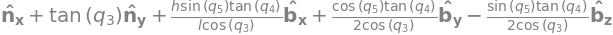

In [35]:
N_w_B = B.ang_vel_in(N).xreplace(qd_repl).xreplace(ur_repl).xreplace(d_repl)

N_v_Ao = Ao.vel(N).xreplace(qd_repl).xreplace(ur_repl).xreplace(d_repl)
N_v_Bo = Bo.vel(N).xreplace(qd_repl).xreplace(ur_repl).xreplace(d_repl)
N_v_Co = Co.vel(N).xreplace(qd_repl).xreplace(ur_repl).xreplace(d_repl)
N_v_COM = COM.vel(N).xreplace(qd_repl).xreplace(ur_repl).xreplace(d_repl)

vels = ( N_w_B, N_v_Ao, N_v_Bo, N_v_Co, N_v_COM)
w_B, v_Ao, v_Bo, v_Co, v_COM = me.partial_velocity(vels, us, N) # I dont think I need Ao, Bo , Co but they are here in case

fnd = fn.diff(t).xreplace(qd_repl)
Mnd = fnd.jacobian(urd)
gnd = fnd.xreplace(urd_zero).xreplace(ur_repl)
urd_sol = Mnd.LUsolve(-gnd)
urd_repl = dict(zip(urd, urd_sol))

I_B_Bo = me.inertia(B, I_xx, I_yy, I_zz)
v_COM[0].simplify()

In [36]:
R_COM = -m*g*N.z # gravity is in the negative direction becasue opposite N.x which is up, and Fr = - PE/dqi so I expect it to be 
# T_steer = q4 * A.z

Fr_1 = v_COM[0].dot(R_COM) #+ w_B[0].dot(T_steer)
Fr_2 = v_COM[1].dot(R_COM) #+ w_B[1].dot(T_steer)
# Fr_3 = v_COM[2].dot(R_COM)
Fr = sm.Matrix([Fr_1, Fr_2])

qdd_repl = {k.diff(t): v.diff(t).xreplace(urd_repl) for k, v in qd_repl.items()}
u1_dot = {u1.diff(t) :0}


Rs_COM = -m*COM.acc(N).xreplace(qdd_repl).xreplace(qd_repl).xreplace(ur_repl).xreplace(d_repl)#.xreplace(u1_dot)

Ts_B = (-B.ang_acc_in(N).dot(I_B_Bo) - me.cross(B.ang_vel_in(N), I_B_Bo).dot(B.ang_vel_in(N))).xreplace(qdd_repl).xreplace(qd_repl).xreplace(ur_repl).xreplace(d_repl)#.xreplace(u1_dot)
## if the accelerations are negative in Rs and Ts then the mass matrix is positive but the gd is much larger than it should be 

Frs = []
for i in range(len(us)):
    Frs.append(v_COM[i].dot(Rs_COM) 
               + w_B[i].dot(Ts_B))
Frs = sm.Matrix(Frs)

# #us = sm.Matrix([u1, u5])
# Rs_1 = N_v_COM.diff(u1, N).dot(Rs_COM)#.xreplace(u1_dot)#  * 0
# Rs_2 = N_v_COM.diff(u5, N).dot(Rs_COM)#.xreplace(u1_dot)

# Ts_1 = N_w_B.diff(u1, N).dot(Ts_B)#.xreplace(u1_dot) #* 0# when this is zero the term still apears butif R* is also 0 it doesnt
# Ts_2 = N_w_B.diff(u5, N).dot(Ts_B)#.xreplace(u1_dot)
 
# Frs_1 = Rs_1 + Ts_1
# Frs_2 = Rs_2 + Ts_2
# Frs = sm.Matrix([Frs_1, Frs_2])


############################## both methods solving Frs give me the exact same numeric values ###############################
# u5d = sm.Matrix([u5.diff(t)])
# u5d_zero = {u5.diff(t): 0 }
Md = Frs.jacobian(usd)
gd = Frs.xreplace(usd_zero) + Fr
# me.find_dynamicsymbols(Frs[0])
# Md = sm.trigsimp(Md)
me.find_dynamicsymbols(Frs)

# sm.trigsimp(Md)
# Md_red = sm.Matrix([Md[1:, 1:]])  # Ignore the first row and column
# gd_red = sm.Matrix([ gd[1:] ])    # Ignore the first element

# Md_red = sm.Matrix([Md[:, 1:]])
# sm.trigsimp(Md_red)

# sm.trigsimp(gd)

In [37]:
eval_kd = sm.lambdify((q, us, p, steer), (Mk, gk, Md, gd), cse=True)

p_vals = np.array([
    1,  # l [m]
    1,  # I [kg*m^2]
    87,  # m [kg]
    9.81, # g 
    9.2,  # Ixx
    11.0, #Iyy
    2.8,  #Izz
    1,    # h
])

q0 = np.array([
    0,  # q1 [m]
    0,  # q2 [m]
    np.deg2rad(0.0),  # q3 [rad] yaw # changing this doesnt change numeric value which is good
    np.deg2rad(10.0),  # q5 [rad] lean
])

us0 = np.array([
    5,  # u1 [m/s]
    0.0,  # u5 [m/s] 
])

steer_val = np.array([
    np.deg2rad(10), # detla 
    0.01,           # delta_dot [rad/s]
])

x0 = np.hstack((q0, us0))
p_vals, x0
Mk, gk, Md, gd = eval_kd(q0, us0, p_vals, steer_val)
Md, gd

## Md is correct mag but I get a negative?
## good thing is that the first mass, so u1 (long vel) stuff is zero which we expect
## if I change Frs the u1 gd is -15.18... so it changes but I expect 



(array([[-93.18022189,   7.55369573],
        [  7.55369573, -96.2       ]]),
 array([[ -1.02812107],
        [540.75109303]]))

In [38]:
def eval_rhs(t, x, p):
    q, us = x[:4], x[4:]

    gain = 2.5 #### ratio of v^2/9.81 * 1/wheelbase @ v = 5
    steer = [gain*(np.deg2rad(5.0) - q[3]), -gain*us[1]] ## has to be us not u because that is what it turns x into!!!
     
    # steer = [np.deg2rad(5), 0.0]

    Mk, gk, Md_red, gd = eval_kd(q, us, p, steer)

    # # Reduce Md and gd to a non-singular subsystem
    # Md_reduced = Md[1:, 1:]  # Ignore the first row and column
    # gd_reduced = gd[1:]      # Ignore the first element

    # Solve the reduced system
    qd = -np.linalg.solve(Mk, gk.squeeze())
    usd = -np.linalg.solve(Md_red, gd.squeeze())
    # usd_reduced = -gd_reduced/Md_reduced

    # # Pad the reduced solution with zeros to match the original size
    # usd = np.zeros_like(us)
    # usd[1:] = usd_reduced  # Fill in the reduced solution

    return np.hstack((qd, usd))


def roll_angle_event(t, x, p):
    """
    Event function to stop the solver if roll angle (theta) exceeds 60 or goes below -60 degrees.
    """
    roll_angle = np.rad2deg(x[3])  # x[3] is the roll angle (theta), converted to degrees
    max_angle = 30  # Upper and lower bounds in degrees
    
    # Return the difference between the roll angle and the bounds
    # The event is triggered when this value crosses zero
    return roll_angle**2 - max_angle**2  # Returns 0 when |roll_angle| == max_angle

# Set the event properties
roll_angle_event.terminal = True  # Stop the solver when the event is triggered
roll_angle_event.direction = 0    # Detect event when crossing from either direction (positive or negative)

p_vals = np.array([
    0.7,  # l [m]
    0.1,  # I [kg*m^2]
    87,  # m [kg]
    9.81, # g 
    9.2,  # Ixx
    11.0, #Iyy
    2.8,  #Izz
    1,    # h
])

q0 = np.array([
    0,  # q1 [m]
    0,  # q2 [m]
    np.deg2rad(0.0),  # q3 [rad] yaw
    # np.deg2rad(5),    # q4 [rad] steer
    np.deg2rad(8.0),  # q5 [rad] lean
])

us0 = np.array([
    3,  # u3 [m/s]
    # 0.1,  # u4 [rad/s] steer
    0.0,  # u5 [rad/s] lean
])

x0 = np.hstack((q0, us0))
p_vals, x0

t0, tf = 0.0, 30.0
fps = 20

ts = np.linspace(t0, tf, num=int(fps*(tf - t0)))

sol = solve_ivp(eval_rhs, (t0, tf), x0, args=(p_vals,), t_eval=ts,  events=roll_angle_event)


In [39]:
# eval_kd = sm.lambdify((q, us, p, steer), (Mk, gk, Md, gd), cse=True)

# def eval_rhs(t, x, p):
#     q, us = x[:4], x[4:]
    
#     steer = [np.deg2rad(15), 2]

#     Mk, gk, Md, gd = eval_kd(q, us, p, steer)

#     qd = -np.linalg.solve(Mk, gk.squeeze())
#     usd = -np.linalg.solve(Md, gd.squeeze())

#     return np.hstack((qd, usd))

# p_vals = np.array([
#     0.7,  # l [m]
#     0.1,  # I [kg*m^2]
#     87,  # m [kg]
#     9.81, # g 
#     9.2,  # Ixx
#     11.0, #Iyy
#     2.8,  #Izz
#     1,    # h
# ])

# q0 = np.array([
#     0,  # q1 [m]
#     1,  # q2 [m]
#     np.deg2rad(5.0),  # q3 [rad] yaw
#     # np.deg2rad(5),    # q4 [rad] steer
#     np.deg2rad(0.0),  # q5 [rad] lean
# ])

# us0 = np.array([
#     5,  # u3 [m/s]
#     # 0.1,  # u4 [rad/s] steer
#     1,  # u5 [rad/s] lean
# ])

# x0 = np.hstack((q0, us0))
# p_vals, x0

# t0, tf = 0.0, 30.0
# fps = 20

# ts = np.linspace(t0, tf, num=int(fps*(tf - t0)))

# sol = solve_ivp(eval_rhs, (t0, tf), x0, args=(p_vals,), t_eval=ts)



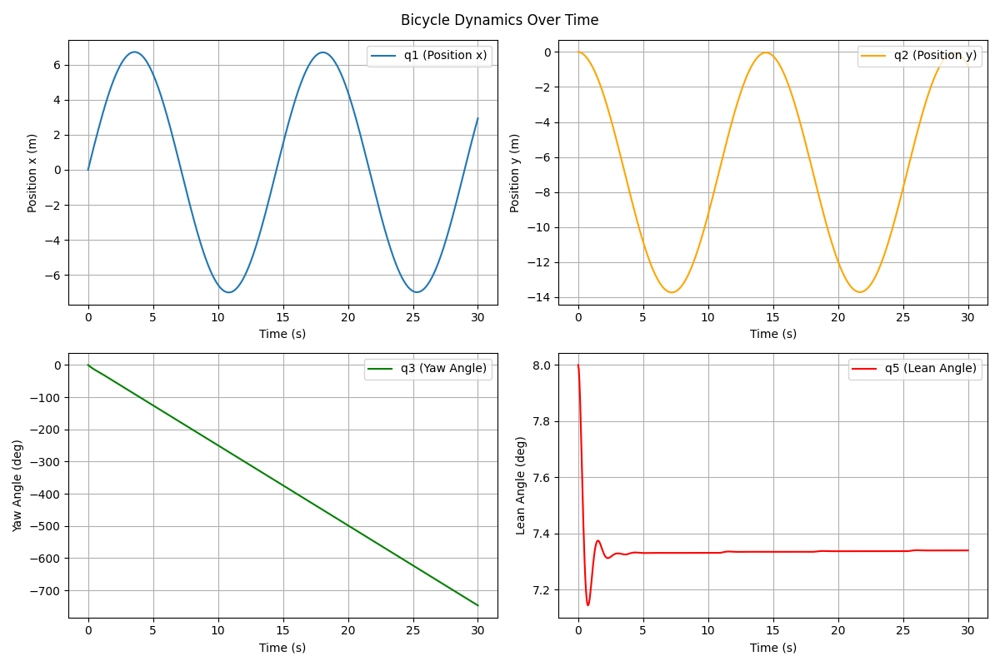

In [40]:
# Assuming sol is the solution object from solve_ivp
xs = np.transpose(sol.y)  # Extract states
ts = sol.t  # Extract time points

# Create a figure with 4 subplots (2 rows, 2 columns)
fig, axs = plt.subplots(2, 2, figsize=(12, 8))  # 2 rows, 2 columns
fig.suptitle('Bicycle Dynamics Over Time')

# Plot q1 (position x) in the first subplot
axs[0, 0].plot(ts, xs[:, 0], label='q1 (Position x)')
axs[0, 0].set_xlabel('Time (s)')
axs[0, 0].set_ylabel('Position x (m)')
axs[0, 0].legend(loc='upper right')  # Legend in top right corner
axs[0, 0].grid()

# Plot q2 (position y) in the second subplot
axs[0, 1].plot(ts, xs[:, 1], label='q2 (Position y)', color='orange')
axs[0, 1].set_xlabel('Time (s)')
axs[0, 1].set_ylabel('Position y (m)')
axs[0, 1].legend(loc='upper right')  # Legend in top right corner
axs[0, 1].grid()

# Plot q3 (yaw angle) in the third subplot
axs[1, 0].plot(ts, np.rad2deg(xs[:, 2]), label='q3 (Yaw Angle)', color='green')
axs[1, 0].set_xlabel('Time (s)')
axs[1, 0].set_ylabel('Yaw Angle (deg)')
axs[1, 0].legend(loc='upper right')  # Legend in top right corner
axs[1, 0].grid()

# Plot q5 (lean angle) in the fourth subplot
axs[1, 1].plot(ts, np.rad2deg(xs[:, 3]), label='q5 (Lean Angle)', color='red')
axs[1, 1].set_xlabel('Time (s)')
axs[1, 1].set_ylabel('Lean Angle (deg)')
axs[1, 1].legend(loc='upper right')  # Legend in top right corner
axs[1, 1].grid()

# Adjust layout to prevent overlap
plt.tight_layout()

# Show the plot
plt.show()

In [41]:
# Extract x[3] (the fourth state)
x3_values = sol.y[3, :]  # x[3] at all time steps
print("Max x[3]:", np.rad2deg(np.max(x3_values)))
print("Min x[3]:", np.rad2deg(np.min(x3_values)))
np.deg2rad(90)

Max x[3]: 8.0
Min x[3]: 7.143529087302115


In [42]:
# def extract_positions(solution):
#     """Extract the positions of the COM, Wf, and Wb from the solution."""
#     xB_vals = sol.y[0]  # xB is the x position
#     yB_vals = sol.y[1]  # yB is the y position
#     yaw_vals = sol.y[2]  # yaw is the y position
#     theta_vals = sol.y[3]  # theta is the y position
    
#     # Assuming the positions of Wf and Wb are also influenced by the q and u
#     # For simplicity, this example assumes no relative movement of Wf and Wb along the z axis
#     q = solution.y[0:4, :]  # generalized coordinates
#     u = solution.y[4:, :]  # generalized speeds
    
#     # Recalculate positions of Wf and Wb from q and u if needed
#     Rear_x = xB_vals
#     Rear_y = yB_vals
    
#     Front_x = xB_vals + p_vals[0] * np.cos(yaw_vals)
#     Front_y = yB_vals + p_vals[0] * np.cos(yaw_vals)

#     CB_x = xB_vals + p_vals[0]/2 * np.cos(yaw_vals) 
#     CB_y = yB_vals + p_vals[0]/2 * np.sin(yaw_vals)

#     COM_x = CB_x + p_vals[6] * np.sin(yaw_vals) * np.sin(theta_vals)
#     COM_y = CB_y + p_vals[6] * np.sin(theta_vals) * np.sin(yaw_vals)
#     COM_z = -p_vals[6] * np.cos(theta_vals)

#     return Rear_x, Rear_y, Front_x, Front_y, CB_x, CB_y, COM_x, COM_y, COM_z

# # Extracting positions for both scenarios
# Rear_x, Rear_y, Front_x, Front_y, CB_x, CB_y, COM_x, COM_y, COM_z= extract_positions(sol)
# #xB_with_slip, yB_with_slip, Wf_x_with_slip, Wf_y_with_slip, Wb_x_with_slip, Wb_y_with_slip = extract_positions(sol_lagrange_with_forces)

# # Plotting the results
# plt.figure(figsize=(10, 8))

# # Plot for COM
# plt.plot(Rear_x, Rear_y, 'b-', label="Rear Path (No Slip)")
# #plt.plot(xB_with_slip, yB_with_slip, 'r--', label="COM Path (With Slip)")

# # Plot for Wf
# plt.plot(Front_x, Front_y, 'g-', label="Front Wheel Path (No Slip)")
# #plt.plot(Wf_x_with_slip, Wf_y_with_slip, 'y--', label="Front Wheel Path (With Slip)")

# # Plot for Wb
# plt.plot(COM_x, COM_y, 'c-', label="COM Wheel Path (No Slip)")
# #plt.plot(Wb_x_with_slip, Wb_y_with_slip, 'm--', label="Rear Wheel Path (With Slip)")

# # Add legend and labels
# plt.xlabel("X Position")
# plt.ylabel("Y Position")
# plt.title("Comparison of Paths With and Without Slip")
# plt.legend()
# plt.grid(True)
# plt.axis('equal')
# plt.show()

In [43]:

# import numpy as np
# import matplotlib.pyplot as plt
# from mpl_toolkits.mplot3d import Axes3D  # Import the 3D toolkit

# def extract_positions(solution):
#     """Extract the positions of the COM, Wf, and Wb from the solution."""
#     xB_vals = solution.y[0]  # xB is the x position
#     yB_vals = solution.y[1]  # yB is the y position
#     yaw_vals = solution.y[2]  # yaw is the yaw angle
#     theta_vals = solution.y[3]  # theta is the pitch angle

#     # Recalculate positions of Wf and Wb from q and u if needed
#     Rear_x = xB_vals
#     Rear_y = yB_vals

#     Front_x = xB_vals + p_vals[0] * np.cos(yaw_vals)
#     Front_y = yB_vals + p_vals[0] * np.sin(yaw_vals)

#     CB_x = xB_vals + p_vals[0] / 2 * np.cos(yaw_vals)
#     CB_y = yB_vals + p_vals[0] / 2 * np.sin(yaw_vals)

#     COM_x = CB_x - p_vals[6] * np.sin(yaw_vals) * np.sin(theta_vals)
#     COM_y = CB_y - p_vals[6] * np.sin(theta_vals) * np.sin(yaw_vals)
#     COM_z = -p_vals[6] * np.cos(theta_vals)

#     return Rear_x, Rear_y, Front_x, Front_y, CB_x, CB_y, COM_x, COM_y, COM_z

# # Extracting positions for the solution
# Rear_x, Rear_y, Front_x, Front_y, CB_x, CB_y, COM_x, COM_y, COM_z = extract_positions(sol)

# # Create a 3D plot
# fig = plt.figure(figsize=(10, 8))
# ax = fig.add_subplot(111, projection='3d')  # Create a 3D axis

# # Plot the paths in 3D
# ax.plot(Rear_x, Rear_y, np.zeros_like(Rear_x), 'b-', label="Rear Path (No Slip)")
# ax.plot(Front_x, Front_y, np.zeros_like(Front_x), 'g-', label="Front Wheel Path (No Slip)")
# ax.plot(COM_x, COM_y, COM_z, 'r-', label="COM Path (No Slip)")

# # Add labels and legend
# ax.set_xlabel("X Position")
# ax.set_ylabel("Y Position")
# ax.set_zlabel("Z Position")
# ax.set_title("3D Paths of COM, Front Wheel, and Rear Wheel")
# ax.legend()
# ax.grid(True)

# # Set manual scaling for axes
# ax.set_xlim([min(Rear_x), max(Rear_x)])
# ax.set_ylim([min(Rear_y), max(Rear_y)])
# ax.set_zlim([min(COM_z), max(COM_z)])

# # Set the view so that the positive Z-axis is pointing upwards
# ax.view_init(elev=20, azim=-120)  # Adjust elev and azim as needed

# plt.show()


Text(0, 0.5, '$y$ [m]')

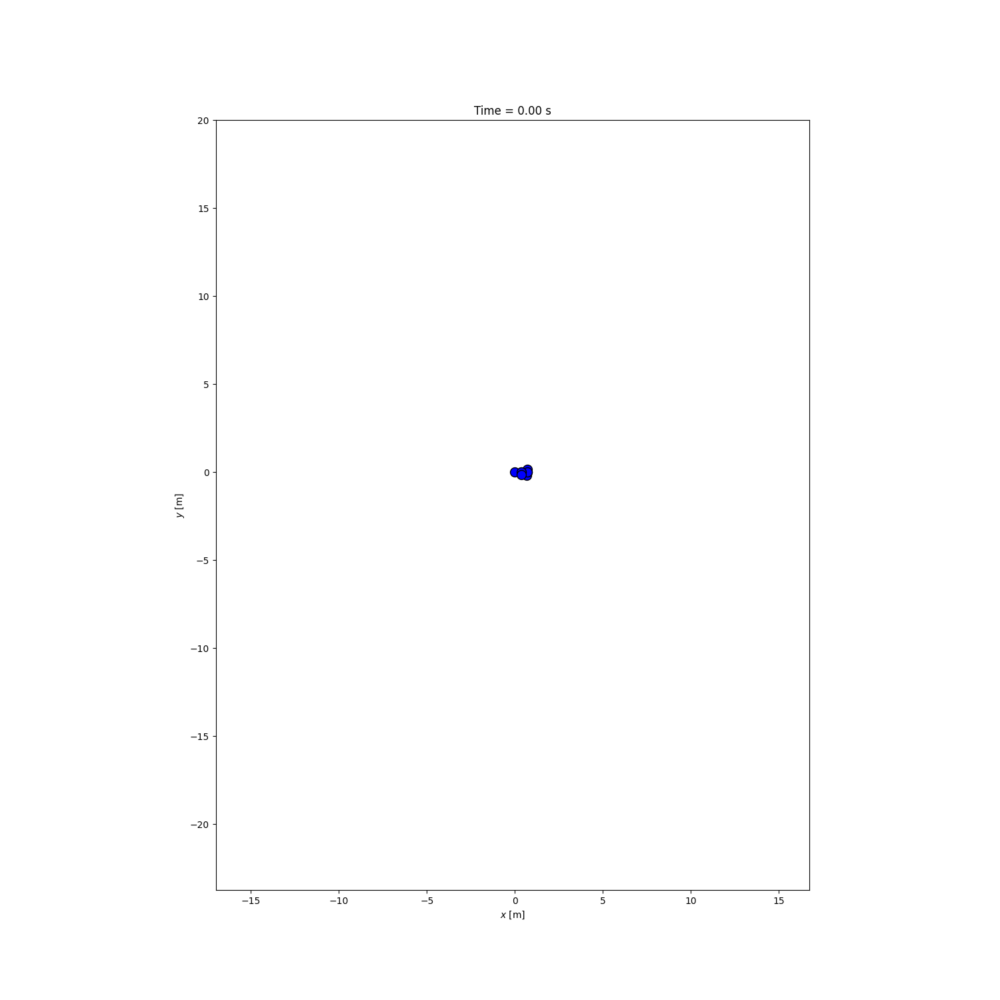

In [44]:
Bl = me.Point('B_l')
Br = me.Point('B_r')
Bl.set_pos(Bo, -l/4*C.y)
Br.set_pos(Bo, l/4*C.y)

steer_val = [np.deg2rad(-8), 0.1]
coordinates = Bo.pos_from(O).to_matrix(N)
for point in [Bl, Bo, Br, Bo, Ao, Co, Ao, COM]:
    coordinates = coordinates.row_join(point.pos_from(O).to_matrix(N))

eval_point_coords = sm.lambdify((q, p, steer), coordinates, cse=True)
eval_point_coords(q0, p_vals, steer_val)

x, y, z = eval_point_coords(q0, p_vals, steer_val)

fig, ax = plt.subplots()
fig.set_size_inches((15.0, 15.0))
ax.set_aspect('equal')

lines, = ax.plot(x, y, color='black',
                 marker='o', markerfacecolor='blue', markersize=10)
# some empty lines to use for the wheel paths
bl_path, = ax.plot([], [])
br_path, = ax.plot([], [])


title_template = 'Time = {:1.2f} s'
title_text = ax.set_title(title_template.format(t0))
ax.set_xlim((np.min(xs[:, 0]) - 10, np.max(xs[:, 0]) + 10))
ax.set_ylim((np.min(xs[:, 1]) - 10, np.max(xs[:, 1]) + 20))
ax.set_xlabel('$x$ [m]')
ax.set_ylabel('$y$ [m]')

In [45]:
coords = []
for xi in xs:
     coords.append(eval_point_coords(xi[:4], p_vals, steer_val))
coords = np.array(coords)  # shape(600, 3, 8)

from IPython.display import HTML
from matplotlib.animation import FuncAnimation
def animate(i):
    title_text.set_text(title_template.format(sol.t[i]))
    lines.set_data(coords[i, 0, :], coords[i, 1, :])
    bl_path.set_data(coords[:i, 0, 0], coords[:i, 1, 0])
    br_path.set_data(coords[:i, 0, 2], coords[:i, 1, 2])

ani = FuncAnimation(fig, animate, len(sol.t))

HTML(ani.to_jshtml(fps=fps))


Animation size has reached 21057357 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [46]:
# import numpy as np
# import matplotlib.pyplot as plt
# from matplotlib.animation import FuncAnimation
# from IPython.display import HTML


# # Compute coordinates (replace with your actual function)
# coords = []
# for xi in xs:
#      coords.append(eval_point_coords(xi[:4], p_vals, steer_val))
# coords = np.array(coords)  # shape(600, 3, 8)

# # Create a figure and axis
# fig, ax = plt.subplots()
# ax.set_xlim(np.min(coords[:, 0, :]), np.max(coords[:, 0, :]))
# ax.set_ylim(np.min(coords[:, 1, :]), np.max(coords[:, 1, :]))

# # Initialize plot elements
# lines, = ax.plot([], [], 'b-')  # Line for the current frame
# bl_path, = ax.plot([], [], 'r--')  # Path for the bottom-left point
# br_path, = ax.plot([], [], 'g--')  # Path for the bottom-right point
# title_template = 'Time = {:.2f}s'
# title_text = ax.text(0.5, 1.02, '', transform=ax.transAxes, ha='center')

# # Animation function
# def animate(i):
#     title_text.set_text(title_template.format(sol.t[i]))
#     lines.set_data(coords[i, 0, :], coords[i, 1, :])
#     bl_path.set_data(coords[:i, 0, 0], coords[:i, 1, 0])
#     br_path.set_data(coords[:i, 0, 2], coords[:i, 1, 2])
#     return lines, bl_path, br_path, title_text

# # Create the animation
# fps = 30  # Set the frame rate
# ani = FuncAnimation(fig, animate, frames=len(sol.t), interval=1000/fps, blit=True)

# # Display the animation in the notebook
# HTML(ani.to_jshtml(fps=fps))

# # Save the animation as a GIF
# ani.save('animation.gif', writer='pillow', fps=fps)